In [104]:
import numpy as np 
import pandas as pd
import re
## For data visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

## For jupyter notebook widgets
import ipywidgets as widgets
from ipywidgets import interact, interact_manual

## For interactive shells
from IPython.display import display

## Suppress warnings
import warnings
warnings.filterwarnings("ignore")

In [105]:
jobs = pd.read_csv("jobs.csv")

In [106]:
jobs.shape

(66, 14)

In [107]:
jobs.head()

,ID,JobFamily,JobFamilyDescription,JobClass,JobClassDescription,PayGrade,EducationLevel,Experience,OrgImpact,ProblemSolving,Supervision,ContactLevel,FinancialBudget,PG
0,1,1,Accounting And Finance,1,Accountant I,5,3,1,3,3,4,3,5,PG05
1,2,1,Accounting And Finance,2,Accountant II,6,4,1,5,4,5,7,7,PG06
2,3,1,Accounting And Finance,3,Accountant III,8,4,2,6,5,6,7,10,PG08
3,4,1,Accounting And Finance,4,Accountant IV,10,5,5,6,6,7,8,11,PG10
4,5,2,Administrative Support,5,Admin Support I,1,1,0,1,1,1,1,1,PG01


In [108]:
## Checking the missing values
jobs.isna().sum()

ID                      0
JobFamily               0
JobFamilyDescription    0
JobClass                0
JobClassDescription     0
PayGrade                0
EducationLevel          0
Experience              0
OrgImpact               0
ProblemSolving          0
Supervision             0
ContactLevel            0
FinancialBudget         0
PG                      0
dtype: int64

In [109]:
jobs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66 entries, 0 to 65
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   ID                    66 non-null     int64 
 1   JobFamily             66 non-null     int64 
 2   JobFamilyDescription  66 non-null     object
 3   JobClass              66 non-null     int64 
 4   JobClassDescription   66 non-null     object
 5   PayGrade              66 non-null     int64 
 6   EducationLevel        66 non-null     int64 
 7   Experience            66 non-null     int64 
 8   OrgImpact             66 non-null     int64 
 9   ProblemSolving        66 non-null     int64 
 10  Supervision           66 non-null     int64 
 11  ContactLevel          66 non-null     int64 
 12  FinancialBudget       66 non-null     int64 
 13  PG                    66 non-null     object
dtypes: int64(11), object(3)
memory usage: 7.3+ KB


# Exploratory Data Analysis

In [110]:
jobs.columns

Index(['ID', 'JobFamily', 'JobFamilyDescription', 'JobClass',
       'JobClassDescription', 'PayGrade', 'EducationLevel', 'Experience',
       'OrgImpact', 'ProblemSolving', 'Supervision', 'ContactLevel',
       'FinancialBudget', 'PG'],
      dtype='object')

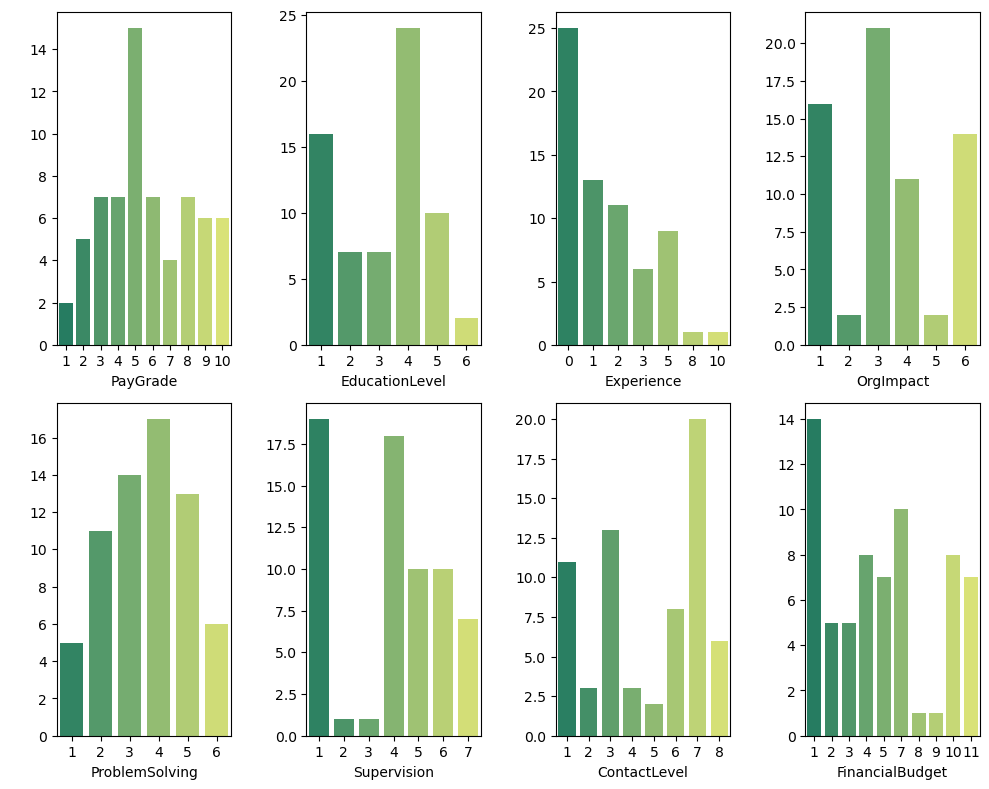

In [111]:
## Plotting each of the metrics
plt.figure(figsize=(10, 8))
plt.subplot(2,4,1)
sns.countplot(x="PayGrade", data=jobs, palette="summer")
plt.ylabel(" ")

plt.subplot(2,4,2)
sns.countplot(x="EducationLevel", data=jobs, palette="summer")
plt.ylabel(" ")

plt.subplot(2,4,3)
sns.countplot(x="Experience", data=jobs, palette="summer")
plt.ylabel(" ")

plt.subplot(2,4,4)
sns.countplot(x="OrgImpact", data=jobs, palette="summer")
plt.ylabel(" ")

plt.subplot(2,4,5)
sns.countplot(x="ProblemSolving", data=jobs, palette="summer")
plt.ylabel(" ")

plt.subplot(2,4,6)
sns.countplot(x="Supervision", data=jobs, palette="summer")
plt.ylabel(" ")

plt.subplot(2,4,7)
sns.countplot(x="ContactLevel", data=jobs, palette="summer")
plt.ylabel(" ")

plt.subplot(2,4,8)
sns.countplot(x="FinancialBudget", data=jobs, palette="summer")
plt.ylabel(" ")

plt.tight_layout()
plt.show()

In [112]:
jobs[['PayGrade', 'EducationLevel', 'Experience',
       'OrgImpact', 'ProblemSolving', 'Supervision', 'ContactLevel',
       'FinancialBudget']]

,PayGrade,EducationLevel,Experience,OrgImpact,ProblemSolving,Supervision,ContactLevel,FinancialBudget
0,5,3,1,3,3,4,3,5
1,6,4,1,5,4,5,7,7
2,8,4,2,6,5,6,7,10
3,10,5,5,6,6,7,8,11
4,1,1,0,1,1,1,1,1
5,2,1,1,1,1,1,2,3
6,3,1,2,1,2,1,3,3
7,4,4,0,1,2,1,3,5
8,5,4,0,4,3,5,7,7
9,4,2,0,1,4,1,1,2


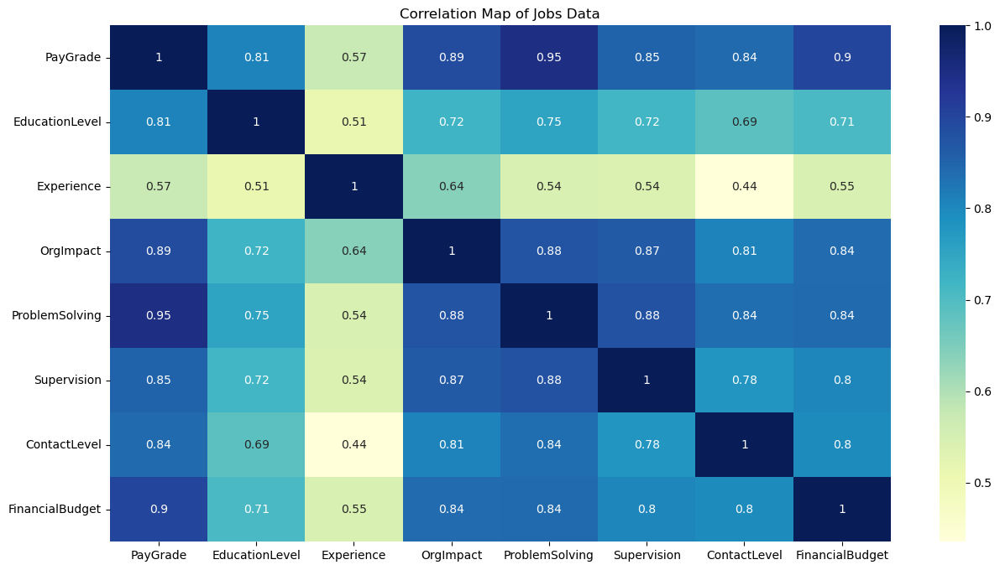

In [113]:
sns.heatmap(jobs[['PayGrade', 'EducationLevel', 'Experience',
       'OrgImpact', 'ProblemSolving', 'Supervision', 'ContactLevel',
       'FinancialBudget']].corr(), annot=True, cmap="YlGnBu")
plt.title("Correlation Map of Jobs Data")
plt.show()

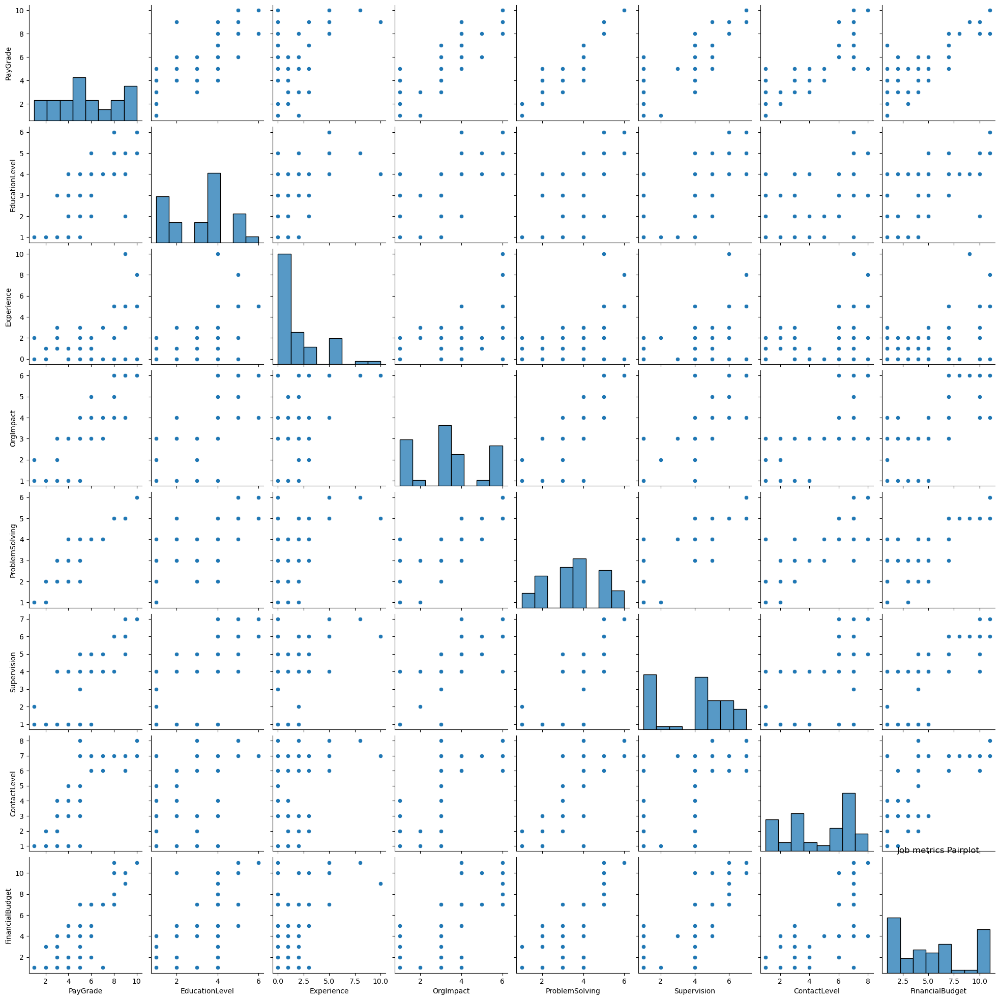

In [114]:
sns.pairplot(jobs[['PayGrade', 'EducationLevel', 'Experience',
       'OrgImpact', 'ProblemSolving', 'Supervision', 'ContactLevel',
       'FinancialBudget']])
plt.title("Job metrics Pairplot")
plt.show()

In [115]:
## Let's analyze these metrics in the light of each job described
x = jobs.groupby(["JobFamilyDescription"]).agg("mean")
x = x.drop(["ID", "JobFamily", "JobClass"], axis=1)
x.style.background_gradient(cmap="YlGnBu")

,PayGrade,EducationLevel,Experience,OrgImpact,ProblemSolving,Supervision,ContactLevel,FinancialBudget
JobFamilyDescription,,,,,,,,
Accounting And Finance,7.250000,4.000000,2.250000,5.000000,4.500000,5.500000,6.250000,8.250000
Administrative Support,3.000000,2.200000,0.600000,1.600000,1.800000,1.800000,3.200000,3.800000
Baker,6.333333,2.000000,0.000000,2.666667,4.333333,2.333333,4.333333,5.333333
Buildings And Facilities,5.500000,2.375000,0.500000,3.000000,3.750000,4.125000,5.000000,5.000000
Buyer,7.333333,3.333333,3.666667,5.000000,4.333333,5.333333,5.666667,7.333333
Cashier,3.333333,2.666667,2.333333,2.666667,2.666667,3.666667,3.333333,3.000000
Communications And Media,4.500000,2.500000,0.300000,2.000000,2.900000,2.800000,4.000000,3.800000
Corporate Research,5.800000,4.000000,2.400000,3.400000,3.600000,3.800000,3.400000,5.200000
Finance And Accounting,6.666667,4.000000,2.000000,4.000000,4.333333,5.000000,5.333333,7.333333


In [116]:
len(x.index)

15

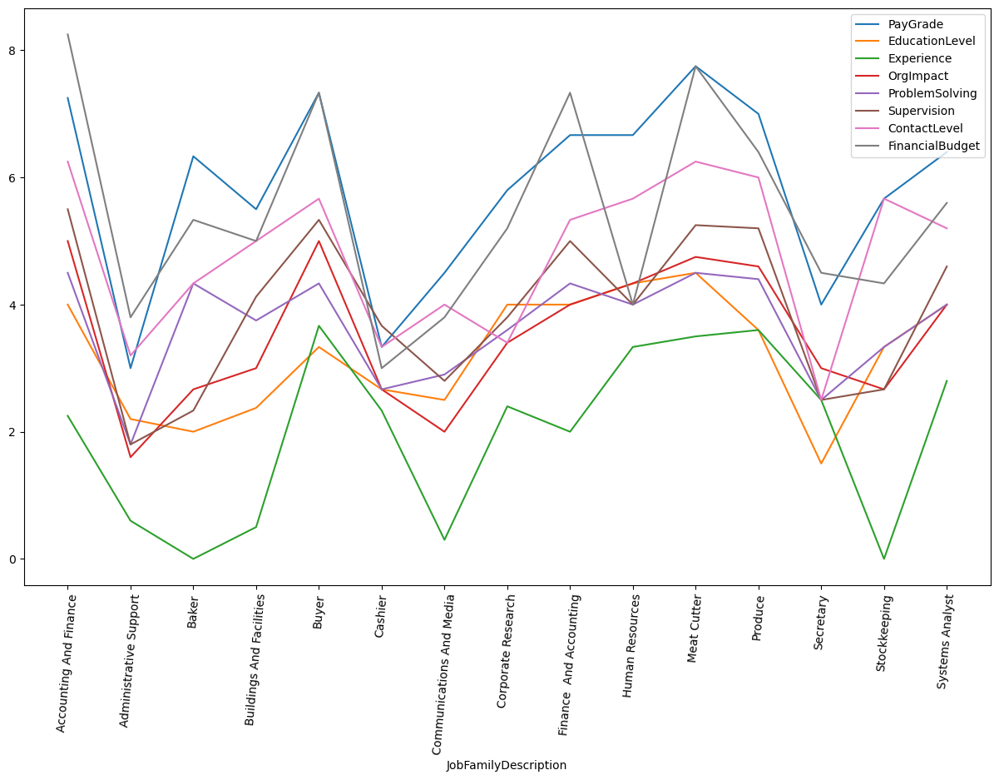

In [117]:
plt.rcParams["figure.figsize"] = (15,9)
plt.rcParams["legend.loc"] = "best"
x.plot()
plt.xticks(np.arange(len(x.index)), x.index, rotation=85,)
plt.show()

In [118]:
@interact
def check(column = jobs.select_dtypes("number").columns[3:],
         columns = jobs.select_dtypes("number").columns[4:]):
    sns.barplot(jobs[column], jobs[columns])
    plt.xticks(rotation=85, fontsize=15)
    plt.yticks(fontsize=15)
    plt.show()

interactive(children=(Dropdown(description='column', options=('PayGrade', 'EducationLevel', 'Experience', 'Org…

## Working on a New jobs dataset

In [198]:
data = pd.read_csv("naukri.csv")

In [199]:
data.shape

(22000, 14)

In [200]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22000 entries, 0 to 21999
Data columns (total 14 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   company              21996 non-null  object 
 1   education            20004 non-null  object 
 2   experience           21996 non-null  object 
 3   industry             21995 non-null  object 
 4   jobdescription       21996 non-null  object 
 5   jobid                22000 non-null  int64  
 6   joblocation_address  21499 non-null  object 
 7   jobtitle             22000 non-null  object 
 8   numberofpositions    4464 non-null   float64
 9   payrate              21903 non-null  object 
 10  postdate             21977 non-null  object 
 11  site_name            3987 non-null   object 
 12  skills               21472 non-null  object 
 13  uniq_id              22000 non-null  object 
dtypes: float64(1), int64(1), object(12)
memory usage: 2.3+ MB


In [201]:
data.head()

,company,education,experience,industry,jobdescription,jobid,joblocation_address,jobtitle,numberofpositions,payrate,postdate,site_name,skills,uniq_id
0,MM Media Pvt Ltd,UG: B.Tech/B.E. - Any Specialization PG:Any Po...,0 - 1 yrs,Media / Entertainment / Internet,Job Description Send me Jobs like this Quali...,210516002263,Chennai,Walkin Data Entry Operator (night Shift),NaN,"1,50,000 - 2,25,000 P.A",2016-05-21 19:30:00 +0000,NaN,ITES,43b19632647068535437c774b6ca6cf8
1,find live infotech,UG: B.Tech/B.E. - Any Specialization PG:MBA/PG...,0 - 0 yrs,Advertising / PR / MR / Event Management,Job Description Send me Jobs like this Quali...,210516002391,Chennai,Work Based Onhome Based Part Time.,60.0,"1,50,000 - 2,50,000 P.A. 20000",2016-05-21 19:30:00 +0000,NaN,Marketing,d4c72325e57f89f364812b5ed5a795f0
2,Softtech Career Infosystem Pvt. Ltd,UG: Any Graduate - Any Specialization PG:Any P...,4 - 8 yrs,IT-Software / Software Services,Job Description Send me Jobs like this - as ...,101016900534,Bengaluru,Pl/sql Developer - SQL,NaN,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,NaN,IT Software - Application Programming,c47df6f4cfdf5b46f1fd713ba61b9eba
3,Onboard HRServices LLP,UG: Any Graduate - Any Specialization PG:CA Do...,11 - 15 yrs,Banking / Financial Services / Broking,Job Description Send me Jobs like this - Inv...,81016900536,"Mumbai, Bengaluru, Kolkata, Chennai, Coimbator...",Manager/ad/partner - Indirect Tax - CA,NaN,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,NaN,Accounts,115d28f140f694dd1cc61c53d03c66ae
4,Spire Technologies and Solutions Pvt. Ltd.,UG: B.Tech/B.E. - Any Specialization PG:Any Po...,6 - 8 yrs,IT-Software / Software Services,Job Description Send me Jobs like this Pleas...,120916002122,Bengaluru,JAVA Technical Lead (6-8 yrs) -,4.0,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,NaN,IT Software - Application Programming,a12553fc03bc7bcced8b1bb8963f97b4


In [202]:
data.isna().sum()

company                    4
education               1996
experience                 4
industry                   5
jobdescription             4
jobid                      0
joblocation_address      501
jobtitle                   0
numberofpositions      17536
payrate                   97
postdate                  23
site_name              18013
skills                   528
uniq_id                    0
dtype: int64

In [203]:
round(100*data.isna().sum()/data.shape[0], 2)

company                 0.02
education               9.07
experience              0.02
industry                0.02
jobdescription          0.02
jobid                   0.00
joblocation_address     2.28
jobtitle                0.00
numberofpositions      79.71
payrate                 0.44
postdate                0.10
site_name              81.88
skills                  2.40
uniq_id                 0.00
dtype: float64

In [204]:
data.drop(["jobid", "uniq_id"], inplace=True, axis=1)

In [205]:
data.head()

,company,education,experience,industry,jobdescription,joblocation_address,jobtitle,numberofpositions,payrate,postdate,site_name,skills
0,MM Media Pvt Ltd,UG: B.Tech/B.E. - Any Specialization PG:Any Po...,0 - 1 yrs,Media / Entertainment / Internet,Job Description Send me Jobs like this Quali...,Chennai,Walkin Data Entry Operator (night Shift),NaN,"1,50,000 - 2,25,000 P.A",2016-05-21 19:30:00 +0000,NaN,ITES
1,find live infotech,UG: B.Tech/B.E. - Any Specialization PG:MBA/PG...,0 - 0 yrs,Advertising / PR / MR / Event Management,Job Description Send me Jobs like this Quali...,Chennai,Work Based Onhome Based Part Time.,60.0,"1,50,000 - 2,50,000 P.A. 20000",2016-05-21 19:30:00 +0000,NaN,Marketing
2,Softtech Career Infosystem Pvt. Ltd,UG: Any Graduate - Any Specialization PG:Any P...,4 - 8 yrs,IT-Software / Software Services,Job Description Send me Jobs like this - as ...,Bengaluru,Pl/sql Developer - SQL,NaN,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,NaN,IT Software - Application Programming
3,Onboard HRServices LLP,UG: Any Graduate - Any Specialization PG:CA Do...,11 - 15 yrs,Banking / Financial Services / Broking,Job Description Send me Jobs like this - Inv...,"Mumbai, Bengaluru, Kolkata, Chennai, Coimbator...",Manager/ad/partner - Indirect Tax - CA,NaN,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,NaN,Accounts
4,Spire Technologies and Solutions Pvt. Ltd.,UG: B.Tech/B.E. - Any Specialization PG:Any Po...,6 - 8 yrs,IT-Software / Software Services,Job Description Send me Jobs like this Pleas...,Bengaluru,JAVA Technical Lead (6-8 yrs) -,4.0,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,NaN,IT Software - Application Programming


# Cleaning the Job Location Address

In [206]:
data["joblocation_address"] = data["joblocation_address"].str.split(",")

In [207]:
data["joblocation_address"]

0                                                [Chennai]
1                                                [Chennai]
2                                              [Bengaluru]
3        [Mumbai,  Bengaluru,  Kolkata,  Chennai,  Coim...
4                                              [Bengaluru]
5                                              [Bengaluru]
6        [Delhi NCR,  Mumbai,  Bengaluru,  Kochi,  Grea...
7                                              [Bengaluru]
8                                              [Bengaluru]
9                                              [Bengaluru]
10                            [Mumbai,  Delhi,  Bengaluru]
11                                             [Bengaluru]
12                                             [Bengaluru]
13                                             [Bengaluru]
14                                             [Bengaluru]
15                                             [Bengaluru]
16                                             [Bengalur

In [208]:
data.head()

,company,education,experience,industry,jobdescription,joblocation_address,jobtitle,numberofpositions,payrate,postdate,site_name,skills
0,MM Media Pvt Ltd,UG: B.Tech/B.E. - Any Specialization PG:Any Po...,0 - 1 yrs,Media / Entertainment / Internet,Job Description Send me Jobs like this Quali...,[Chennai],Walkin Data Entry Operator (night Shift),NaN,"1,50,000 - 2,25,000 P.A",2016-05-21 19:30:00 +0000,NaN,ITES
1,find live infotech,UG: B.Tech/B.E. - Any Specialization PG:MBA/PG...,0 - 0 yrs,Advertising / PR / MR / Event Management,Job Description Send me Jobs like this Quali...,[Chennai],Work Based Onhome Based Part Time.,60.0,"1,50,000 - 2,50,000 P.A. 20000",2016-05-21 19:30:00 +0000,NaN,Marketing
2,Softtech Career Infosystem Pvt. Ltd,UG: Any Graduate - Any Specialization PG:Any P...,4 - 8 yrs,IT-Software / Software Services,Job Description Send me Jobs like this - as ...,[Bengaluru],Pl/sql Developer - SQL,NaN,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,NaN,IT Software - Application Programming
3,Onboard HRServices LLP,UG: Any Graduate - Any Specialization PG:CA Do...,11 - 15 yrs,Banking / Financial Services / Broking,Job Description Send me Jobs like this - Inv...,"[Mumbai, Bengaluru, Kolkata, Chennai, Coim...",Manager/ad/partner - Indirect Tax - CA,NaN,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,NaN,Accounts
4,Spire Technologies and Solutions Pvt. Ltd.,UG: B.Tech/B.E. - Any Specialization PG:Any Po...,6 - 8 yrs,IT-Software / Software Services,Job Description Send me Jobs like this Pleas...,[Bengaluru],JAVA Technical Lead (6-8 yrs) -,4.0,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,NaN,IT Software - Application Programming


In [209]:
data = data.explode('joblocation_address')
pd.set_option('max_rows', 30000)
data['joblocation_address'].value_counts()

Bengaluru/Bangalore                               3775
Mumbai                                            2593
Bengaluru/Bangalore                               2134
Bengaluru                                         2026
 Mumbai                                           1378
Chennai                                           1290
Hyderabad / Secunderabad                          1246
Hyderabad                                         1154
Mumbai                                            1067
 Mumbai                                            923
 Chennai                                           905
Delhi                                              790
Noida                                              777
Gurgaon                                            762
 Chennai                                           738
 Hyderabad / Secunderabad                          700
Delhi                                              680
 Pune                                              645
 Delhi    

In [210]:

data['joblocation_address'] = data['joblocation_address'].replace(('(Bengaluru/Bangalore)',' Bangalore',
                                                                ' Bangalore ','Bangalore ','Bengaluru/Bangalore ',
                                                                 ' Bengaluru/Bangalore ',' Bengaluru/Bangalore',
                                                                'Bengaluru/Bangalore','Bengaluru','NCR Bangalore',
                                                                'NCR Bangalore ','Near Bangalore', ' Bengaluru/Bangalore',
                                                                 ' Bengaluru/Bangalore ', ' Bengaluru',
                                                                 'Bangalore , Bangalore / Bangalore',
                                                                 'Bangalore , karnataka',' Bengaluru / Bangalore', 
                                                                 ' Bengaluru / Bangalore ', 'Bengaluru Bangalore',
                                                                 'India-Karnataka-Bangalore',' bangalore',' karnataka',
                                                                ' Bengaluru Bangalore'),
                                                                ('Bangalore','Bangalore','Bangalore','Bangalore','Bangalore',
                                                                'Bangalore','Bangalore','Bangalore','Bangalore','Bangalore',
                                                                'Bangalore','Bangalore','Bangalore','Bangalore','Bangalore',
                                                                 'Bangalore','Bangalore', 'Bangalore','Bangalore','Bangalore',
                                                                'Bangalore','Bangalore','Bangalore','Bangalore',))
                                                                
data['joblocation_address'] = data['joblocation_address'].replace(('Hyderabad / Secunderabad',' Hyderabad / Secunderabad',
                                                                 ' Hyderabad / Secunderabad ','Hyderabad / Secunderabad ',
                                                                ' Hyderabad','Hyderabad ',' Hyderabad ',
                                                                 'Hyderabad/Secunderabad','Hyderabad/Secunderabad ',
                                                                ' Hyderabad/Secunderabad ',' Hyderabad/Secunderabad',),
                                                                ('Hyderabad', 'Hyderabad','Hyderabad','Hyderabad',
                                                                 'Hyderabad', 'Hyderabad','Hyderabad','Hyderabad',
                                                                'Hyderabad','Hyderabad','Hyderabad'))


  
data['joblocation_address'] = data['joblocation_address'].replace(('NAVI MUMBAI',' NAVI MUMBAI','NAVI MUMBAI ',
                                                                 ' NAVI MUMBAI',' NAVI MUMBAI ','Mumbai , Mumbai',
                                                                 ' Mumbai',' Mumbai ','Mumbai ','mumbai','Navi Mumbai',
                                                                ' Navi Mumbai',' Navi Mumbai ','Navi Mumbai ', 
                                                                 ' Mumbai Suburbs','Mumbai Suburbs ','Mumbai Suburbs',
                                                                ' Mumbai Suburbs ','mumbai',' mumbai','mumbai ',
                                                                 ' maharashtra'),
                                                                ('Mumbai','Mumbai','Mumbai','Mumbai','Mumbai','Mumbai',
                                                                 'Mumbai','Mumbai','Mumbai', 'Mumbai','Mumbai','Mumbai',
                                                                'Mumbai','Mumbai','Mumbai','Mumbai','Mumbai','Mumbai','Mumbai',
                                                                'Mumbai','Mumbai', 'Mumbai'))

data['joblocation_address'] = data['joblocation_address'].replace(('Noida','Noida ',' Noida',' Delhi','Delhi','Delhi ',' Delhi ',
                                                                 'Gurgaon',' Gurgaon',' Gurgaon ','Gurgaon ', ' noida',
                                                                 ' Noida/Greater Noida',' Noida ', ' Delhi NCR',
                                                                 'Delhi/NCR(National Capital Region)',' Delhi/NCR ',
                                                                 ' Delhi/NCR(National Capital Region)',
                                                                 ' Delhi/NCR(National Capital Region) ',
                                                                 'Delhi/NCR(National Capital Region) ','Delhi , Delhi',
                                                                 'Noida , Noida/Greater Noida','Ghaziabad',
                                                                 'Delhi/NCR(National Capital Region) , Gurgaon',
                                                                 'NCR , NCR','NCR/NCR(National Capital Region)',
                                                                'NCR , NCR/Greater NCR','NCR/NCR(National Capital Region), NCR',
                                                                 'NCR , NCR/NCR(National Capital Region)',
                                                                 'NCR/NCR(National Capital Region)','NCR/Greater NCR',
                                                                 'NCR/NCR(National Capital Region) , NCR','Delhi/NCR ',
                                                                ' Noida/Greater Noida','Greater Noida',' Greater Noida',
                                                                 ' Greater Noida ','Greater Noida ','Ghaziabad',' Ghaziabad',
                                                                 'Ghaziabad ',' Ghaziabad ','Faridabad','Faridabad ',
                                                                 ' Faridabad',' Faridabad ',' Noida/Greater Noida',
                                                                 ' Noida/Greater Noida ',' delhi',' Delhi/NCR','Delhi NCR'
                                                                ),
                                                                ('NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR',
                                                                'NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR',
                                                                'NCR','NCR','NCR','NCR','NCR','NCR', 'NCR','NCR','NCR','NCR',
                                                                 'NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR',
                                                                 'NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR','NCR',
                                                                'NCR'))


data['joblocation_address'] = data['joblocation_address'].replace(('Chennai ',' Chennai',' Chennai ',' Chennai',
                                                                 'chennai ',' chennai',' chennai ',' chennai',),
                                                                ('Chennai', 'Chennai','Chennai','Chennai','Chennai',
                                                                'Chennai','Chennai','Chennai',))

data['joblocation_address'] = data['joblocation_address'].replace(('Pune ',' Pune',' Pune '),('Pune','Pune','Pune'))
data['joblocation_address'] = data['joblocation_address'].replace(('Kolkata ',' Kolkata',' Kolkata ',
                                                                ' kolkata','kolkata ',' kolkata'),
                                                                ('Kolkata','Kolkata','Kolkata',
                                                                  'Kolkata','Kolkata','Kolkata'))
data['joblocation_address'] = data['joblocation_address'].replace((' Ahmedabad','Ahmedabad ',' Ahmedabad '),('Ahmedabad',
                                                                                         'Ahmedabad','Ahmedabad'))
data['joblocation_address'] = data['joblocation_address'].replace(('Chandigarh ',' Chandigarh',' Chandigarh '),
                                                                ('Chandigarh','Chandigarh','Chandigarh'))
data['joblocation_address'] = data['joblocation_address'].replace(('Surat ',' Surat',' Surat '),
                                                                ('Surat','Surat','Surat'))
data['joblocation_address'] = data['joblocation_address'].replace(('Ernakulam / Kochi/ Cochin ', ' Kochi', 'Kochi ',' Kochi ',
                                                                 ' Cochin/ Kochi/ Ernakulam', ' Cochin/ Kochi/ Ernakulam ', 
                                                                 ' Ernakulam / Kochi/ Cochin',' Ernakulam / Kochi/ Cochin '),
                                                                ('Kochi','Kochi','Kochi','Kochi','Kochi','Kochi','Kochi',
                                                                 'Kochi',))
data['joblocation_address'] = data['joblocation_address'].replace(('Coimbatore ',' Coimbatore',' Coimbatore '),
                                                                ('Coimbatore','Coimbatore','Coimbatore'))
data['joblocation_address'] = data['joblocation_address'].replace(('Coimbatore ',' Coimbatore',' Coimbatore '),
                                                                ('Coimbatore','Coimbatore','Coimbatore'))
data['joblocation_address'] = data['joblocation_address'].replace(('Lucknow ',' Lucknow',' Lucknow '),
                                                                ('Lucknow','Lucknow','Lucknow'))
data['joblocation_address'] = data['joblocation_address'].replace(('Jaipur ',' Jaipur',' Jaipur ','jaipur ',' jaipur',
                                                                 ' jaipur '),
                                                                ('Jaipur','Jaipur','Jaipur','Jaipur','Jaipur','Jaipur'))
data['joblocation_address'] = data['joblocation_address'].replace(('Vijayawada ',' Vijayawada',' Vijayawada '),
                                                                ('Vijayawada','Vijayawada','Vijayawada'))
data['joblocation_address'] = data['joblocation_address'].replace(('Visakhapatnam ',' Visakhapatnam',' Visakhapatnam ',
                                                                'Visakhapatnam/Vizag ',' Visakhapatnam/Vizag',
                                                                 ' Visakhapatnam/Vizag '),
                                                                ('Visakhapatnam','Visakhapatnam','Visakhapatnam',
                                                                 'Visakhapatnam','Visakhapatnam','Visakhapatnam',
                                                                ))

data['joblocation_address'] = data['joblocation_address'].replace((' Bhubaneshwar',' Bhubaneshwar',' Bhubaneshwar '),
                                                                ('Bhubaneshwar','Bhubaneshwar','Bhubaneshwar'))
data['joblocation_address'] = data['joblocation_address'].replace((' Patna',' Patna',' Patna '),
                                                                ('Patna','Patna','Patna'))

data['joblocation_address'] = data['joblocation_address'].replace((' Trivandrum',' Trivandrum',' Trivandrum '),
                                                                ('Trivandrum','Trivandrum','Trivandrum'))

data['joblocation_address'] = data['joblocation_address'].replace((' Mangalore',' Mangalore',' Mangalore '),
                                                                ('Mangalore','Mangalore','Mangalore'))
data['joblocation_address'] = data['joblocation_address'].replace((' Indore',' Indore',' Indore '),
                                                                ('Indore','Indore','Indore'))
data['joblocation_address'] = data['joblocation_address'].replace((' Guwahati',' Guwahati',' Guwahati '),
                                                                ('Guwahati','Guwahati','Guwahati'))
data['joblocation_address'] = data['joblocation_address'].replace((' Nagpur',' Nagpur',' Nagpur '),
                                                                ('Nagpur','Nagpur','Nagpur'))
data['joblocation_address'] = data['joblocation_address'].replace((' Raipur',' Raipur',' Raipur '),
                                                                ('Raipur','Raipur','Raipur'))
data['joblocation_address'] = data['joblocation_address'].replace((' Thane',' Thane',' Thane '),
                                                                ('Thane','Thane','Thane'))
data['joblocation_address'] = data['joblocation_address'].replace((' Bhopal',' Bhopal',' Bhopal '),
                                                                ('Bhopal','Bhopal','Bhopal'))
data['joblocation_address'] = data['joblocation_address'].replace((' Vadodara/Baroda',' Vadodara/Baroda',' Vadodara/Baroda ',
                                                                ' Vadodara','Vadodara ',' Vadodara '),
                                                                ('Vadodara','Vadodara','Vadodara','Vadodara',
                                                                 'Vadodara','Vadodara',))
                                                                                                                                  


In [211]:
pd.set_option('max_rows', 2400)
data['joblocation_address'].value_counts()

Bangalore                                         9963
NCR                                               8668
Mumbai                                            6403
Hyderabad                                         4570
Chennai                                           3373
Pune                                              1227
Kolkata                                            543
Ahmedabad                                          404
Chandigarh                                         189
Kochi                                              140
Coimbatore                                         136
Jaipur                                             131
Visakhapatnam                                      125
Surat                                              106
Lucknow                                            101
Vijayawada                                          84
Bhubaneshwar                                        74
Trivandrum                                          69
Vadodara  

In [212]:
counts = data["joblocation_address"].value_counts()
data = data.loc[data["joblocation_address"].isin(counts.index[counts > 25])]
display(data["joblocation_address"].value_counts())

Bangalore        9963
NCR              8668
Mumbai           6403
Hyderabad        4570
Chennai          3373
Pune             1227
Kolkata           543
Ahmedabad         404
Chandigarh        189
Kochi             140
Coimbatore        136
Jaipur            131
Visakhapatnam     125
Surat             106
Lucknow           101
Vijayawada         84
Bhubaneshwar       74
Trivandrum         69
Vadodara           65
Indore             63
Mangalore          57
Thane              48
Nagpur             45
Bhopal             42
Guwahati           39
Raipur             32
Patna              26
Name: joblocation_address, dtype: int64

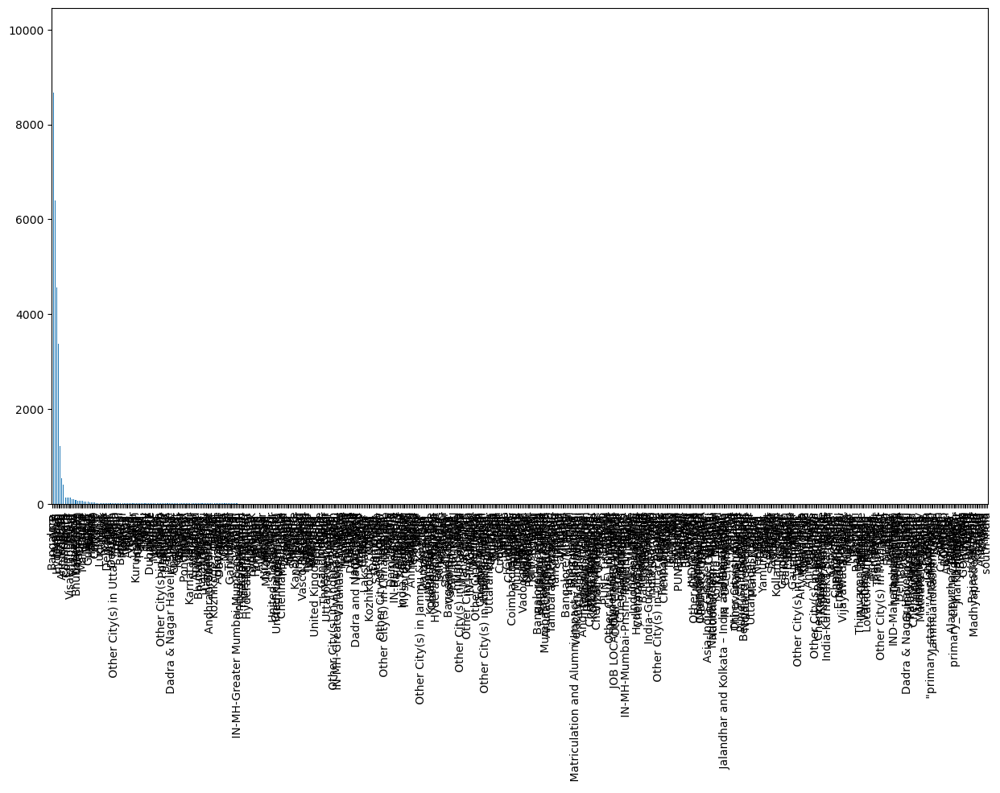

In [213]:
counts.plot.bar()
plt.show()

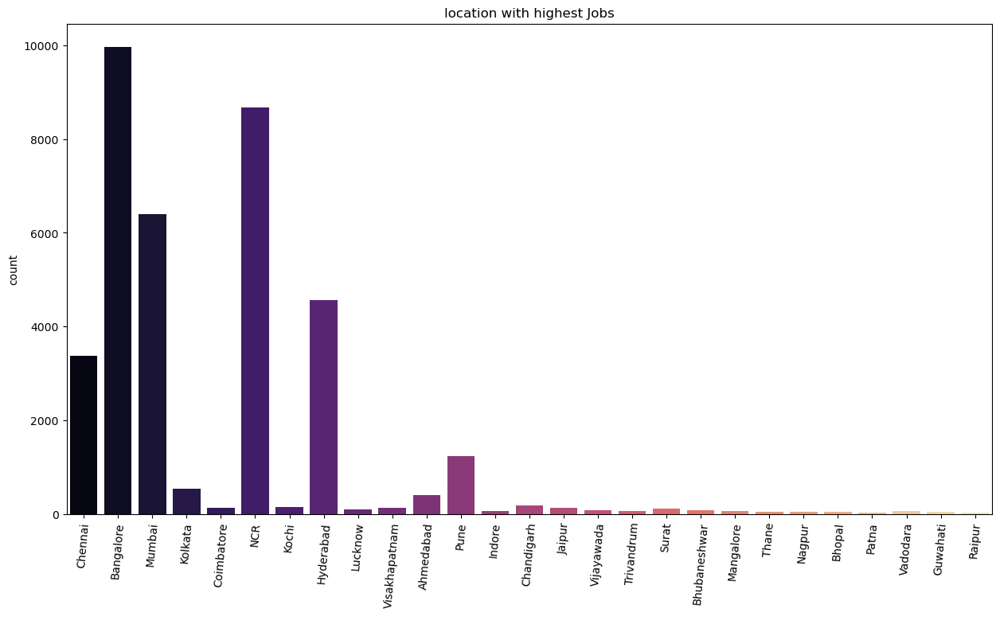

In [214]:
sns.countplot(x = "joblocation_address", data = data, palette = "magma")
plt.title("location with highest Jobs", fontsize = 12)
plt.xlabel(' ')
plt.xticks(rotation = 85)
plt.show()

# Analyzing experience required for Jobs

In [215]:
data["experience"]

0          0 - 1 yrs
1          0 - 0 yrs
2          4 - 8 yrs
3        11 - 15 yrs
3        11 - 15 yrs
            ...     
21996      3 - 5 yrs
21997      2 - 4 yrs
21998     7 - 12 yrs
21998     7 - 12 yrs
21999     5 - 10 yrs
Name: experience, Length: 36723, dtype: object

In [216]:
pd.set_option("max_rows", 40000)
data["experience"].str.split(" ")

0          [0, -, 1, yrs]
1          [0, -, 0, yrs]
2          [4, -, 8, yrs]
3        [11, -, 15, yrs]
3        [11, -, 15, yrs]
3        [11, -, 15, yrs]
3        [11, -, 15, yrs]
3        [11, -, 15, yrs]
4          [6, -, 8, yrs]
5          [2, -, 5, yrs]
6          [1, -, 3, yrs]
6          [1, -, 3, yrs]
6          [1, -, 3, yrs]
6          [1, -, 3, yrs]
6          [1, -, 3, yrs]
6          [1, -, 3, yrs]
6          [1, -, 3, yrs]
6          [1, -, 3, yrs]
7          [2, -, 7, yrs]
8          [1, -, 3, yrs]
9          [1, -, 5, yrs]
10         [1, -, 3, yrs]
10         [1, -, 3, yrs]
10         [1, -, 3, yrs]
11         [4, -, 8, yrs]
12         [2, -, 4, yrs]
13         [3, -, 8, yrs]
14         [1, -, 5, yrs]
15         [5, -, 7, yrs]
16         [1, -, 2, yrs]
17         [2, -, 4, yrs]
18        [5, -, 10, yrs]
19         [0, -, 1, yrs]
20         [1, -, 5, yrs]
21        [5, -, 10, yrs]
22         [3, -, 8, yrs]
23        [6, -, 10, yrs]
24       [10, -, 12, yrs]
25         [

In [217]:
experience = data["experience"].str.split(" ")

In [218]:
experience.apply(lambda x: x if len(x) < 3 else None)

0                    None
1                    None
2                    None
3                    None
3                    None
3                    None
3                    None
3                    None
4                    None
5                    None
6                    None
6                    None
6                    None
6                    None
6                    None
6                    None
6                    None
6                    None
7                    None
8                    None
9                    None
10                   None
10                   None
10                   None
11                   None
12                   None
13                   None
14                   None
15                   None
16                   None
17                   None
18                   None
19                   None
20                   None
21                   None
22                   None
23                   None
24                   None
25          

In [219]:
data["Min Experience"] = experience.apply(lambda x: x[0])
data["Max Experience"] = experience.apply(lambda x: x[2] if len(x) > 2 else x[1])

In [220]:
data["Min Experience"].value_counts()

2      7301
0      6340
3      5343
1      4490
5      3329
4      3135
6      1530
10     1430
8      1292
7      1048
9       486
12      315
15      285
Not     111
11       75
13       74
14       63
20       26
18       25
16       16
17        6
23        1
25        1
26        1
Name: Min Experience, dtype: int64

In [221]:
data["Max Experience"].value_counts()

5            6458
7            4494
8            3740
6            3303
3            3233
10           2860
4            2664
9            1815
2            1597
12           1085
1            1064
11           1059
15            834
13            682
20            501
0             358
14            251
18            134
Mentioned     111
16            109
17             94
22             85
25             85
19             27
23             26
24             20
21             12
30             11
28              8
-1              1
27              1
26              1
Name: Max Experience, dtype: int64

In [222]:
data["Min Experience"] = data["Min Experience"].replace("Not", 0)
data["Max Experience"] = data["Max Experience"].replace("Mentioned", 5)
data["Max Experience"] = data["Max Experience"].replace("-1", 5)

In [223]:
## Let's convert the data of these columns into integer type
data["Min Experience"] = data["Min Experience"].astype(int)
data["Max Experience"] = data["Max Experience"].astype(int)

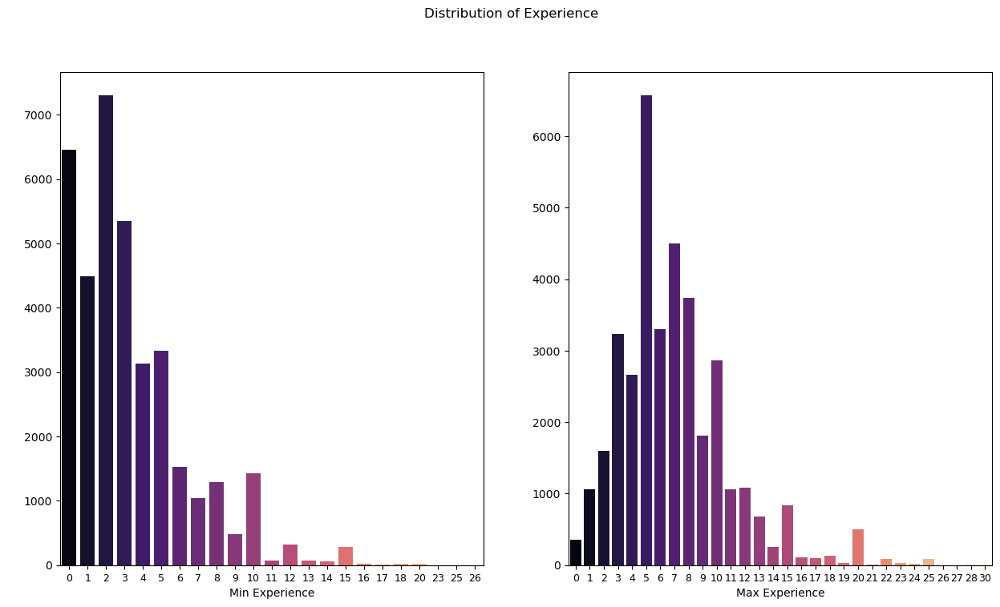

In [224]:
plt.rcParams["figure.figsize"] = (15, 8)

plt.subplot(1,2,1)
sns.countplot(data["Min Experience"], palette = "magma")
plt.xticks(fontsize = 9)
plt.ylabel(" ")

plt.subplot(1,2,2)
sns.countplot(data["Max Experience"], palette = "magma")
plt.xticks(fontsize = 9)
plt.ylabel(" ")

plt.suptitle("Distribution of Experience")
plt.show()

We can observe here that minimum year experience is located between 0 and 3 whereas the maximum year experience is between 3 and 8. 

# Most Demanded Degrees for the Jobs

In [225]:
data.columns

Index(['company', 'education', 'experience', 'industry', 'jobdescription',
       'joblocation_address', 'jobtitle', 'numberofpositions', 'payrate',
       'postdate', 'site_name', 'skills', 'Min Experience', 'Max Experience'],
      dtype='object')

In [226]:
data["education"]

0        UG: B.Tech/B.E. - Any Specialization PG:Any Po...
1        UG: B.Tech/B.E. - Any Specialization PG:MBA/PG...
2        UG: Any Graduate - Any Specialization PG:Any P...
3        UG: Any Graduate - Any Specialization PG:CA Do...
3        UG: Any Graduate - Any Specialization PG:CA Do...
3        UG: Any Graduate - Any Specialization PG:CA Do...
3        UG: Any Graduate - Any Specialization PG:CA Do...
3        UG: Any Graduate - Any Specialization PG:CA Do...
4        UG: B.Tech/B.E. - Any Specialization PG:Any Po...
5        UG: B.Tech/B.E. - Any Specialization PG:MCA - ...
6                                                      NaN
6                                                      NaN
6                                                      NaN
6                                                      NaN
6                                                      NaN
6                                                      NaN
6                                                      N

In [227]:
data["education"] = data["education"].fillna("UG: Any Graduate - Any Specialization")
data["education"].isnull().sum()

0

In [228]:
data["education"] = data["education"].str.split(" ")

In [229]:
data["education"]

0        [UG:, B.Tech/B.E., -, Any, Specialization, PG:...
1        [UG:, B.Tech/B.E., -, Any, Specialization, PG:...
2        [UG:, Any, Graduate, -, Any, Specialization, P...
3        [UG:, Any, Graduate, -, Any, Specialization, P...
3        [UG:, Any, Graduate, -, Any, Specialization, P...
3        [UG:, Any, Graduate, -, Any, Specialization, P...
3        [UG:, Any, Graduate, -, Any, Specialization, P...
3        [UG:, Any, Graduate, -, Any, Specialization, P...
4        [UG:, B.Tech/B.E., -, Any, Specialization, PG:...
5        [UG:, B.Tech/B.E., -, Any, Specialization, PG:...
6             [UG:, Any, Graduate, -, Any, Specialization]
6             [UG:, Any, Graduate, -, Any, Specialization]
6             [UG:, Any, Graduate, -, Any, Specialization]
6             [UG:, Any, Graduate, -, Any, Specialization]
6             [UG:, Any, Graduate, -, Any, Specialization]
6             [UG:, Any, Graduate, -, Any, Specialization]
6             [UG:, Any, Graduate, -, Any, Specializatio

In [230]:
data["education"][0][1]

'B.Tech/B.E.'

In [231]:
data["education"] = data["education"].apply(lambda x: x[1] if len(x) > 1 else x[0])

In [232]:
data["education"].value_counts()

Any                    24216
B.Tech/B.E.             8835
B.Com                    647
B.Sc                     544
Diploma                  441
Graduation               397
B.B.A                    267
B.A                      240
BCA                      174
MBBS                     155
BDS                      109
B.Pharma                  97
Other                     86
B.Ed                      85
LLB                       71
Not                       54
-                         54
BHM                       54
Doctorate                 49
B.Arch                    37
B.Tech/B.E.,              23
B.Sc,                     21
Postgraduate              14
PG:CA                     10
Doctorate:Doctorate        9
B.Pharma,                  7
Diploma,                   5
B.Com,                     5
BCA,                       3
BVSC                       3
B.A,                       3
B.B.A,                     2
MBA/PGDM                   2
PG:Other                   1
B.Des.        

In [233]:
data["education"].unique()

array(['B.Tech/B.E.', 'Any', 'Diploma', 'BHM', 'B.Arch', 'Graduation',
       'LLB', 'B.Com', 'BCA', 'B.Tech/B.E.,', 'B.Sc', 'B.A', 'B.Pharma',
       'Not', '-', 'B.B.A', 'Postgraduate', 'BAMS', 'PG:Other', 'Other',
       'MBBS', 'PG:CA', 'B.Des.', 'BCA,', 'BDS', 'B.Ed', 'Diploma,',
       'B.Sc,', 'Doctorate', 'B.Pharma,', 'B.Com,', 'B.A,', 'MBA/PGDM',
       'BVSC', 'B.B.A,', 'Doctorate:Doctorate', 'BFA'], dtype=object)

In [234]:
data['education'] = data['education'].replace(('B.Tech/B.E.','Graduation','Other','-','Not','B.Tech/B.E.,','Postgraduate',
                                               'PG:CA','Diploma,','B.Com,','B.Pharma,','B.A,','BCA,','B.Sc,','MBA/PGDM','B.B.A,',
                                              'PG:Other','Doctorate:Doctorate','Post'),
                                              ('B.Tech','B.Tech','B.Tech','B.Tech','B.Tech','B.Tech','B.Tech',
                                              'CA','Diploma','B.Com','B.Pharma','B.A','BCA','B.Sc','MBA','BBA',
                                              'B.Tech','Doctorate','B.Tech'))


In [235]:
data["education"].unique()

array(['B.Tech', 'Any', 'Diploma', 'BHM', 'B.Arch', 'LLB', 'B.Com', 'BCA',
       'B.Sc', 'B.A', 'B.Pharma', 'B.B.A', 'BAMS', 'MBBS', 'CA', 'B.Des.',
       'BDS', 'B.Ed', 'Doctorate', 'MBA', 'BVSC', 'BBA', 'BFA'],
      dtype=object)

In [236]:
counts = data["education"].value_counts()
data = data.loc[data["education"].isin(counts.index[counts > 25])]
display(data["education"].value_counts())

Any          24216
B.Tech        9464
B.Com          652
B.Sc           565
Diploma        446
B.B.A          267
B.A            243
BCA            177
MBBS           155
BDS            109
B.Pharma       104
B.Ed            85
LLB             71
Doctorate       58
BHM             54
B.Arch          37
Name: education, dtype: int64

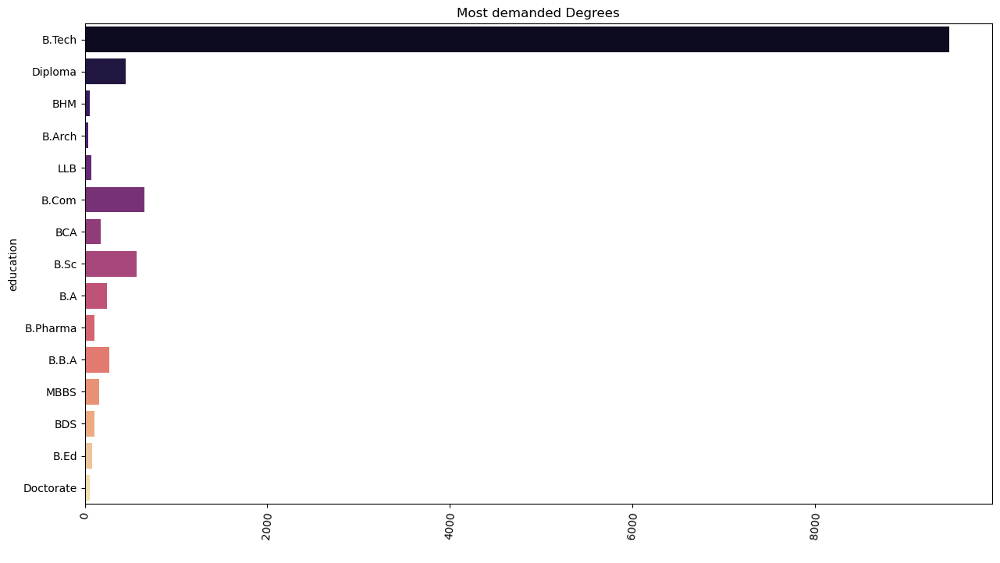

In [237]:
x_education = data[data["education"] != "Any"]
sns.countplot(y=x_education["education"], palette = "magma")
plt.title("Most demanded Degrees", fontsize = 12)
plt.xlabel(' ')
plt.xticks(rotation = 85)
plt.show()

# Analyzing the industries with Highest nb of Jobs

In [238]:
data.columns

Index(['company', 'education', 'experience', 'industry', 'jobdescription',
       'joblocation_address', 'jobtitle', 'numberofpositions', 'payrate',
       'postdate', 'site_name', 'skills', 'Min Experience', 'Max Experience'],
      dtype='object')

In [239]:
data["industry"]

0                         Media / Entertainment / Internet
1                 Advertising / PR / MR / Event Management
2                          IT-Software / Software Services
3                   Banking / Financial Services / Broking
3                   Banking / Financial Services / Broking
3                   Banking / Financial Services / Broking
3                   Banking / Financial Services / Broking
3                   Banking / Financial Services / Broking
4                          IT-Software / Software Services
5                          IT-Software / Software Services
6                          IT-Software / Software Services
6                          IT-Software / Software Services
6                          IT-Software / Software Services
6                          IT-Software / Software Services
6                          IT-Software / Software Services
6                          IT-Software / Software Services
6                          IT-Software / Software Servic

In [240]:
data["industry"].unique()

array(['Media / Entertainment / Internet',
       'Advertising / PR / MR / Event Management',
       'IT-Software / Software Services',
       'Banking / Financial Services / Broking',
       'Aviation / Aerospace Firms',
       'Industrial Products / Heavy Machinery', 'FMCG / Foods / Beverage',
       'Recruitment / Staffing', 'Internet / Ecommerce',
       'Travel / Hotels / Restaurants / Airlines / Railways',
       'BPO / Call Centre / ITES', 'Pharma / Biotech / Clinical Research',
       'Real Estate / Property', 'Insurance', 'Facility Management',
       'Publishing', 'Education / Teaching / Training',
       'Retail / Wholesale',
       'Automobile / Auto Anciliary / Auto Components',
       'Chemicals / PetroChemical / Plastic / Rubber',
       'Government / Defence', 'Accounting / Finance',
       'Textiles / Garments / Accessories',
       'Semiconductors / Electronics', 'Telecom/ISP', 'Legal',
       'Courier / Transportation / Freight / Warehousing',
       'Medical / Healt

In [241]:
data["industry"].isna().sum()

1

In [242]:
data["industry"].mode()

0    IT-Software / Software Services
dtype: object

In [243]:
data["industry"] = data["industry"].fillna(data["industry"].mode()[0])

In [244]:
data["industry"].isna().sum()

0

In [245]:
data["industry"].str.split("/")

0                     [Media ,  Entertainment ,  Internet]
1            [Advertising ,  PR ,  MR ,  Event Management]
2                       [IT-Software ,  Software Services]
3               [Banking ,  Financial Services ,  Broking]
3               [Banking ,  Financial Services ,  Broking]
3               [Banking ,  Financial Services ,  Broking]
3               [Banking ,  Financial Services ,  Broking]
3               [Banking ,  Financial Services ,  Broking]
4                       [IT-Software ,  Software Services]
5                       [IT-Software ,  Software Services]
6                       [IT-Software ,  Software Services]
6                       [IT-Software ,  Software Services]
6                       [IT-Software ,  Software Services]
6                       [IT-Software ,  Software Services]
6                       [IT-Software ,  Software Services]
6                       [IT-Software ,  Software Services]
6                       [IT-Software ,  Software Service

In [246]:
data["industry"] = data["industry"].str.split("/")

In [247]:
data["industry"] = data["industry"].apply(lambda x: x[0])

In [248]:
data["industry"]

0                          Media 
1                    Advertising 
2                    IT-Software 
3                        Banking 
3                        Banking 
3                        Banking 
3                        Banking 
3                        Banking 
4                    IT-Software 
5                    IT-Software 
6                    IT-Software 
6                    IT-Software 
6                    IT-Software 
6                    IT-Software 
6                    IT-Software 
6                    IT-Software 
6                    IT-Software 
6                    IT-Software 
7                       Aviation 
8            Industrial Products 
9                    IT-Software 
10                          FMCG 
10                          FMCG 
10                          FMCG 
11                   IT-Software 
12                   IT-Software 
13                   IT-Software 
14                   IT-Software 
15                   IT-Software 
16            

In [360]:
# To remove the white space at the end of the names
data["industry"] = data["industry"].apply(lambda x: x.split(" ")[0])

In [249]:
data["industry"].value_counts()

IT-Software                 14695
BPO                          2321
Banking                      2111
Education                    1726
Recruitment                  1538
Automobile                   1170
Pharma                       1022
Internet                     1021
Construction                  952
Medical                       873
Travel                        733
Industrial Products           607
Other                         548
Accounting                    547
Strategy                      517
Advertising                   472
IT-Hardware & Networking      442
Telecom                       434
Media                         426
FMCG                          426
Insurance                     400
Retail                        370
Oil and Gas                   347
Real Estate                   306
Consumer Electronics          268
Semiconductors                249
Electricals                   243
Textiles                      194
Courier                       183
KPO           

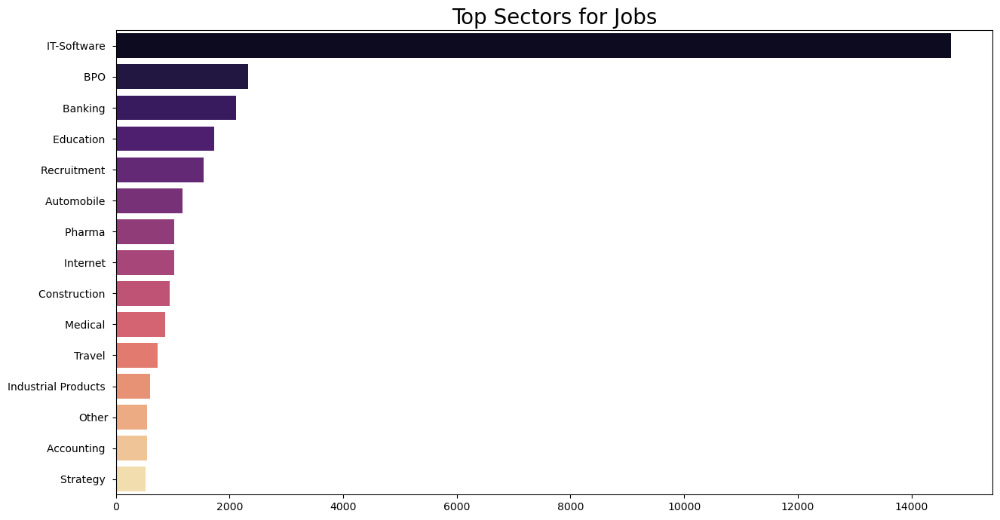

In [250]:
## Showing the industries that are recruiting the most
sns.barplot(y = data["industry"].value_counts().head(15).index,
            x = data["industry"].value_counts().head(15).values,
            palette = "magma")
plt.title("Top Sectors for Jobs", fontsize = 20)
plt.show()

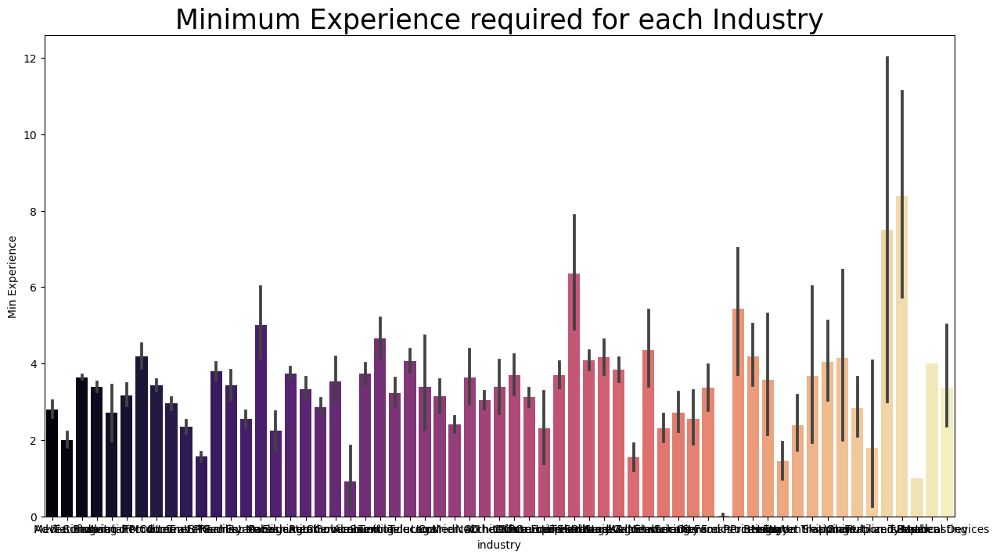

In [251]:
## Minimum of years required for each Industry
plt.title("Minimum Experience required for each Industry", fontsize=25)
sns.barplot(data["industry"], data["Min Experience"], palette = "magma")
plt.show()

# Anamyzing the Top Skills required for Jobs

In [252]:
data["skills"]

0                                           ITES
1                                      Marketing
2          IT Software - Application Programming
3                                       Accounts
3                                       Accounts
3                                       Accounts
3                                       Accounts
3                                       Accounts
4          IT Software - Application Programming
5          IT Software - Application Programming
6          IT Software - Application Programming
6          IT Software - Application Programming
6          IT Software - Application Programming
6          IT Software - Application Programming
6          IT Software - Application Programming
6          IT Software - Application Programming
6          IT Software - Application Programming
6          IT Software - Application Programming
7                                     Production
8                                     Production
9                   

In [253]:
data["skills"].isna().sum()

803

In [254]:
data["skills"] = data["skills"].fillna(data["skills"].mode()[0])

In [255]:
data["skills"].isna().sum()

0

In [256]:
data["skills"] = data["skills"].str.split(" - ")
data["skills"] = data["skills"].apply(lambda x: x[1] if len(x) >1 else x[0])

In [257]:
display(data["skills"].value_counts())

Application Programming              9983
Sales                                5932
ITES                                 2952
Production                           1587
Accounts                             1529
HR                                   1455
Teaching                             1351
Marketing                            1327
Medical                               817
Financial Services                    749
Site Engineering                      672
Other                                 634
Engineering Design                    624
ERP                                   564
eCommerce                             529
Network Administration                507
QA & Testing                          479
IT Hardware                           466
Journalism                            427
DBA                                   424
Supply Chain                          379
Embedded                              368
Design                                342
Hotels                            

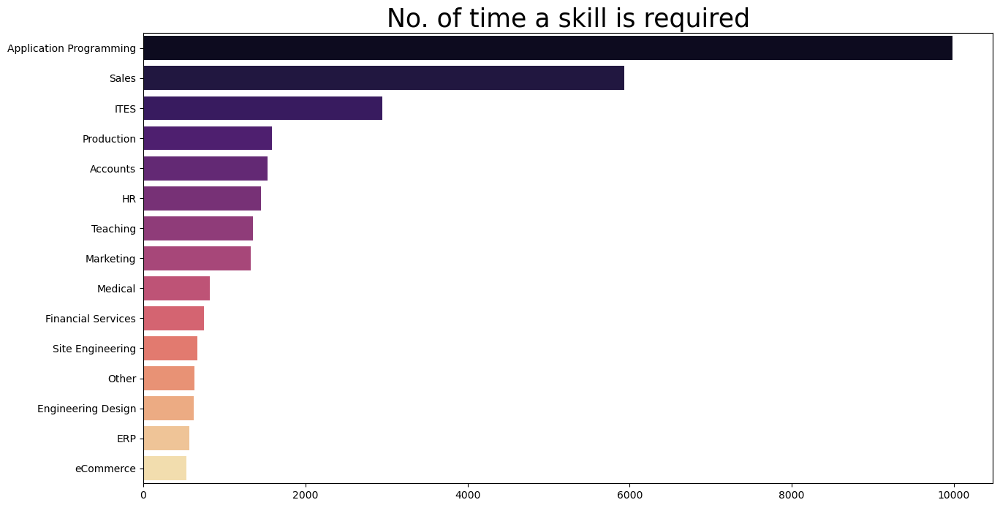

In [258]:
sns.barplot(y = data["skills"].value_counts().head(15).index,
            x = data["skills"].value_counts().head(15).values,
            palette = "magma")
plt.title("No. of time a skill is required", fontsize=25)
plt.show()

In [259]:
data.columns

Index(['company', 'education', 'experience', 'industry', 'jobdescription',
       'joblocation_address', 'jobtitle', 'numberofpositions', 'payrate',
       'postdate', 'site_name', 'skills', 'Min Experience', 'Max Experience'],
      dtype='object')

In [260]:
## Showing the percentage occupied by each skill
data[["skills", "numberofpositions"]].groupby(["skills"]).agg("sum").apply(lambda x: (100*x)/(x.sum())).sort_values(by = "numberofpositions", ascending=False).head(15).style.background_gradient(cmap="copper")

,numberofpositions
skills,
ITES,65.002640
Medical,11.222709
Sales,5.335197
Application Programming,5.155315
Travel,4.974068
Marketing,1.952235
Production,1.371223
HR,0.732942
Accounts,0.568962


# Cleaning the rest of the Dataset

In [261]:
data.columns

Index(['company', 'education', 'experience', 'industry', 'jobdescription',
       'joblocation_address', 'jobtitle', 'numberofpositions', 'payrate',
       'postdate', 'site_name', 'skills', 'Min Experience', 'Max Experience'],
      dtype='object')

In [262]:
## To beging with, let's remove the columns that are not necessary
data = data.drop(["experience", "site_name"], axis=1)

In [263]:
data.columns

Index(['company', 'education', 'industry', 'jobdescription',
       'joblocation_address', 'jobtitle', 'numberofpositions', 'payrate',
       'postdate', 'skills', 'Min Experience', 'Max Experience'],
      dtype='object')

In [264]:
data.head()

,company,education,industry,jobdescription,joblocation_address,jobtitle,numberofpositions,payrate,postdate,skills,Min Experience,Max Experience
0,MM Media Pvt Ltd,B.Tech,Media,Job Description Send me Jobs like this Quali...,Chennai,Walkin Data Entry Operator (night Shift),NaN,"1,50,000 - 2,25,000 P.A",2016-05-21 19:30:00 +0000,ITES,0,1
1,find live infotech,B.Tech,Advertising,Job Description Send me Jobs like this Quali...,Chennai,Work Based Onhome Based Part Time.,60.0,"1,50,000 - 2,50,000 P.A. 20000",2016-05-21 19:30:00 +0000,Marketing,0,0
2,Softtech Career Infosystem Pvt. Ltd,Any,IT-Software,Job Description Send me Jobs like this - as ...,Bangalore,Pl/sql Developer - SQL,NaN,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,Application Programming,4,8
3,Onboard HRServices LLP,Any,Banking,Job Description Send me Jobs like this - Inv...,Mumbai,Manager/ad/partner - Indirect Tax - CA,NaN,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,Accounts,11,15
3,Onboard HRServices LLP,Any,Banking,Job Description Send me Jobs like this - Inv...,Bangalore,Manager/ad/partner - Indirect Tax - CA,NaN,Not Disclosed by Recruiter,2016-10-13 16:20:55 +0000,Accounts,11,15


In [265]:
data.isna().sum()

company                    0
education                  0
industry                   0
jobdescription             0
joblocation_address        0
jobtitle                   0
numberofpositions      27818
payrate                   93
postdate                  29
skills                     0
Min Experience             0
Max Experience             0
dtype: int64

In [266]:
data["numberofpositions"] = data["numberofpositions"].fillna(1)
data["numberofpositions"] = data["numberofpositions"].astype(int)

In [267]:
data.isna().sum()

company                 0
education               0
industry                0
jobdescription          0
joblocation_address     0
jobtitle                0
numberofpositions       0
payrate                93
postdate               29
skills                  0
Min Experience          0
Max Experience          0
dtype: int64

In [268]:
## If the job date and date is missing, it is useless, so less remove the records where "postdate" and "payrate" are missing
data = data.dropna()

In [269]:
data.isna().sum()

company                0
education              0
industry               0
jobdescription         0
joblocation_address    0
jobtitle               0
numberofpositions      0
payrate                0
postdate               0
skills                 0
Min Experience         0
Max Experience         0
dtype: int64

In [270]:
data["postdate"].head(10)

0    2016-05-21 19:30:00 +0000
1    2016-05-21 19:30:00 +0000
2    2016-10-13 16:20:55 +0000
3    2016-10-13 16:20:55 +0000
3    2016-10-13 16:20:55 +0000
3    2016-10-13 16:20:55 +0000
3    2016-10-13 16:20:55 +0000
3    2016-10-13 16:20:55 +0000
4    2016-10-13 16:20:55 +0000
5    2016-10-13 16:20:55 +0000
Name: postdate, dtype: object

In [271]:
data["postdate"] = data["postdate"].str.split(" ")
data["postdate"] = data["postdate"].apply(lambda x: x[0])

In [272]:
data["postdate"].head(10)

0    2016-05-21
1    2016-05-21
2    2016-10-13
3    2016-10-13
3    2016-10-13
3    2016-10-13
3    2016-10-13
3    2016-10-13
4    2016-10-13
5    2016-10-13
Name: postdate, dtype: object

In [273]:
## Now let's get rid of duplicate values

print("No. of rows before removing duplicated values: ", data.shape[0])

data.drop_duplicates(subset=None, keep="first", inplace=True)

print("No. of rows afteer removing duplicated values: ", data.shape[0])

No. of rows before removing duplicated values:  36581
No. of rows afteer removing duplicated values:  32137


# Gathering vital information from the dataset

In [274]:
data["jobtitle"].nunique()

17083

In [275]:
data["skills"].nunique()

45

In [276]:
data["industry"].nunique()

61

In [277]:
data["joblocation_address"].nunique()

27

In [278]:
data["numberofpositions"].sum()

588065

In [283]:
data.columns

Index(['company', 'education', 'industry', 'jobdescription',
       'joblocation_address', 'jobtitle', 'numberofpositions', 'payrate',
       'postdate', 'skills', 'Min Experience', 'Max Experience'],
      dtype='object')

In [284]:
data.company.head(10)

0                              MM Media Pvt Ltd
1                            find live infotech
2           Softtech Career Infosystem Pvt. Ltd
3                        Onboard HRServices LLP
3                        Onboard HRServices LLP
3                        Onboard HRServices LLP
3                        Onboard HRServices LLP
3                        Onboard HRServices LLP
4    Spire Technologies and Solutions Pvt. Ltd.
5               PFS Web Global Services Pvt Ltd
Name: company, dtype: object

In [279]:
from wordcloud import WordCloud, STOPWORDS

In [280]:
stopwords = set(STOPWORDS)

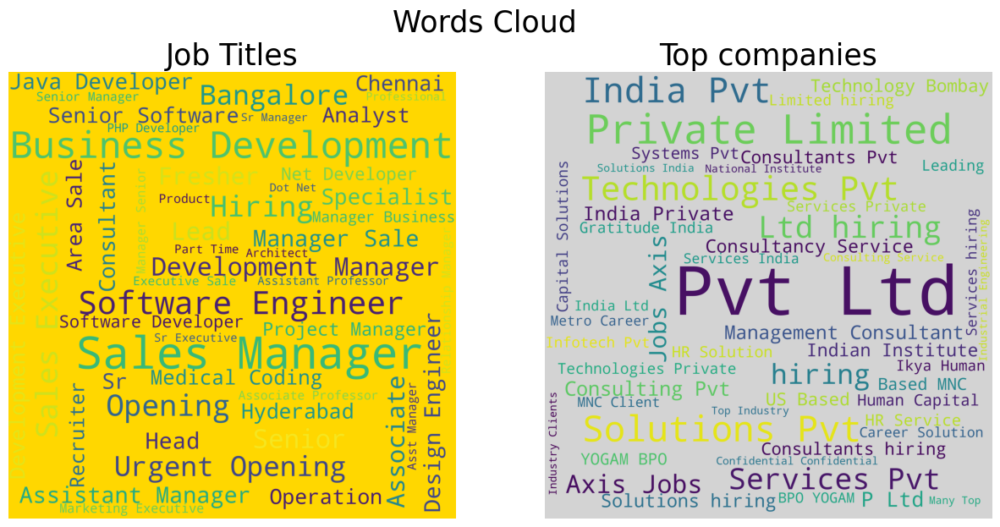

In [286]:
wordcloud = WordCloud(background_color = "gold",
                     max_words = 50,
                     stopwords = stopwords,
                     width=2000,
                     height=2000).generate(" ".join(data["jobtitle"]))

wordcloud2 = WordCloud(background_color = "lightgrey",
                     max_words = 50,
                     stopwords = stopwords,
                     width=2000,
                     height=2000).generate(" ".join(data["company"]))

plt.rcParams["figure.figsize"] = (15, 7)

plt.subplot(1, 2, 1)
plt.imshow(wordcloud)
plt.title('Job Titles', fontsize = 25)
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(wordcloud2)
plt.title('Top companies', fontsize = 25)
plt.axis("off")

plt.suptitle("Words Cloud", fontsize = 25)
plt.show()

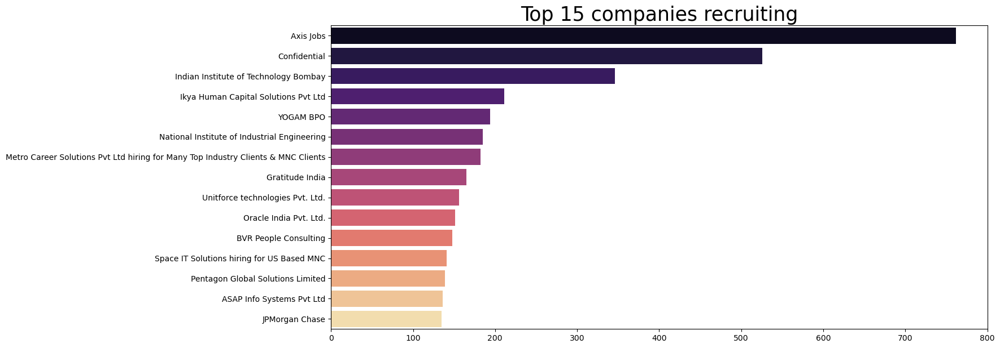

In [288]:
## Let'ss check the top 20 companies providing jobs
sns.barplot(y = data["company"].value_counts().head(15).index,
            x = data["company"].value_counts().head(15).values,
            palette = "magma")
plt.title("Top 15 companies recruiting", fontsize=25)
plt.show()

# Making a function to search for Jobs

In [295]:
data["Min Experience"].value_counts()

2     6103
0     5529
3     4742
1     3885
5     2950
4     2791
6     1386
10    1316
8     1193
7      958
9      469
12     282
15     257
11      72
13      72
14      58
20      25
18      24
16      16
17       6
23       1
25       1
26       1
Name: Min Experience, dtype: int64

In [302]:
data["numberofpositions"].min()

1

In [303]:
pd.set_option("max_rows", 150)

@interact(vacancies=(data["numberofpositions"].min(), data["numberofpositions"].max()))
def search_job(city = list(data["joblocation_address"].value_counts().index),
              industry = list(data["industry"].value_counts().index),
              experience = list(data["Min Experience"].value_counts().index.sort_values(ascending=False)),
              vacancies = 10):
    return data.loc[(data["numberofpositions"] > vacancies)
                   & (data["joblocation_address"] == city)
                   & (data["industry"] == industry)
                   & (data["Min Experience"] == experience)][[
                       "company",
                       "jobtitle",
                       "education",
                       "payrate",
                       "numberofpositions"
                   ]]

interactive(children=(Dropdown(description='city', options=('Bangalore', 'NCR', 'Mumbai', 'Hyderabad', 'Chenna…

## Understanding relation between Industries and Education

In [304]:
## Matrix of education VS industry
x = pd.crosstab(data["education"], data["industry"])
x

industry,Accounting,Advertising,Agriculture,Animation,Architecture,Automobile,Aviation,BPO,Banking,Brewery,...,Security,Semiconductors,Shipping,Strategy,Telecom,Textiles,Travel,Tyres,Water Treatment,Wellness
education,,,,,,,,,,,,,,,,,,,,,
Any,371,300,50,12,49,758,17,1525,1479,7,...,43,124,34,357,261,137,488,7,11,76
B.A,1,7,0,0,2,0,0,1,0,0,...,0,0,0,4,1,1,1,0,0,4
B.Arch,0,0,0,0,14,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
B.B.A,3,4,0,0,0,4,0,6,19,0,...,1,1,0,0,2,0,12,0,0,0
B.Com,74,5,1,1,0,16,0,34,97,0,...,7,3,0,25,11,6,14,0,0,0
B.Ed,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
B.Pharma,0,0,0,0,0,0,0,5,0,0,...,0,0,0,0,0,0,0,0,0,0
B.Sc,7,0,1,0,0,1,1,10,5,0,...,1,1,1,0,0,0,13,0,0,3
B.Tech,49,54,8,7,16,266,15,287,265,0,...,7,95,2,87,113,13,43,1,3,10


In [305]:
@interact
def recomendate_job(industry =list(data["industry"].value_counts().index)):
    job = x[industry]
    similar_jobs = x.corrwith(job)
    similar_jobs = similar_jobs.sort_values(ascending=False)
    similar_jobs = similar_jobs.iloc[2:]
    return similar_jobs.head(3)

interactive(children=(Dropdown(description='industry', options=('IT-Software ', 'BPO ', 'Banking ', 'Education…

In [310]:
data[["joblocation_address", "numberofpositions"]].groupby(["joblocation_address"]).agg("sum").sort_values(by="numberofpositions", ascending=False)

,numberofpositions
joblocation_address,
Bangalore,96415
Hyderabad,81522
NCR,76676
Chennai,75960
Mumbai,61970
Pune,46388
Kolkata,38441
Chandigarh,27001
Ahmedabad,26684


In [ ]:
## The most wanted degrees by the jobs

In [312]:
data.columns

Index(['company', 'education', 'industry', 'jobdescription',
       'joblocation_address', 'jobtitle', 'numberofpositions', 'payrate',
       'postdate', 'skills', 'Min Experience', 'Max Experience'],
      dtype='object')

In [314]:
data.head()

,company,education,industry,jobdescription,joblocation_address,jobtitle,numberofpositions,payrate,postdate,skills,Min Experience,Max Experience
0,MM Media Pvt Ltd,B.Tech,Media,Job Description Send me Jobs like this Quali...,Chennai,Walkin Data Entry Operator (night Shift),1,"1,50,000 - 2,25,000 P.A",2016-05-21,ITES,0,1
1,find live infotech,B.Tech,Advertising,Job Description Send me Jobs like this Quali...,Chennai,Work Based Onhome Based Part Time.,60,"1,50,000 - 2,50,000 P.A. 20000",2016-05-21,Marketing,0,0
2,Softtech Career Infosystem Pvt. Ltd,Any,IT-Software,Job Description Send me Jobs like this - as ...,Bangalore,Pl/sql Developer - SQL,1,Not Disclosed by Recruiter,2016-10-13,Application Programming,4,8
3,Onboard HRServices LLP,Any,Banking,Job Description Send me Jobs like this - Inv...,Mumbai,Manager/ad/partner - Indirect Tax - CA,1,Not Disclosed by Recruiter,2016-10-13,Accounts,11,15
3,Onboard HRServices LLP,Any,Banking,Job Description Send me Jobs like this - Inv...,Bangalore,Manager/ad/partner - Indirect Tax - CA,1,Not Disclosed by Recruiter,2016-10-13,Accounts,11,15


In [315]:
data[["education"]].value_counts()

education
Any          21682
B.Tech        7989
B.Com          585
B.Sc           490
Diploma        329
B.B.A          251
B.A            174
BCA            120
MBBS           115
BDS             89
B.Pharma        86
B.Ed            75
LLB             56
BHM             44
B.Arch          32
Doctorate       20
dtype: int64

In [316]:
## The highest job vacancies by industries
data[["industry", "numberofpositions"]].groupby(["industry"]).agg("sum").sort_values(by="numberofpositions", ascending=False)

,numberofpositions
industry,
BPO,223503
Medical,121102
IT-Software,66194
Pharma,47639
Travel,40889
Advertising,16713
Automobile,10328
Internet,8237
Banking,7940


In [322]:
data[["industry"]].value_counts()

industry                
IT-Software                 12717
BPO                          1878
Banking                      1871
Education                    1504
Recruitment                  1391
Automobile                   1081
Pharma                        936
Internet                      936
Construction                  845
Medical                       750
Travel                        638
Accounting                    508
Industrial Products           507
Strategy                      489
Other                         462
IT-Hardware & Networking      425
Telecom                       390
FMCG                          383
Advertising                   379
Insurance                     347
Media                         345
Retail                        338
Oil and Gas                   318
Real Estate                   271
Consumer Electronics          236
Semiconductors                229
Electricals                   225
Courier                       164
Textiles               

In [352]:
data["industry"]

'Media '

In [380]:
## Industries requiring the least experience
data[["industry", "Min Experience"]].groupby(["industry"]).agg("mean").sort_values(by="Min Experience", ascending=True)

,Min Experience
industry,
Fresher,0.022222
Leather,1.000000
Government,1.000000
Export,1.285714
Wellness,1.559140
BPO,1.747071
Fertilizers,1.928571
Advertising,2.039578
Publishing,2.212766
